In [5]:
import numpy as np
import pandas as pd
import scanpy as sc
import harmonypy as hm
import anndata
import os
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
import scipy.io as io


sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(5,5), facecolor='white')

# set random seed for reproducibility:
np.random.seed(42)


In [104]:
def get_cluster_proportions(adata,
                            cluster_key="cluster_final",
                            sample_key="replicate",
                            drop_values=None):
    """
    Input
    =====
    adata : AnnData object
    cluster_key : key of `adata.obs` storing cluster info
    sample_key : key of `adata.obs` storing sample/replicate info
    drop_values : list/iterable of possible values of `sample_key` that you don't want
    
    Returns
    =======
    pd.DataFrame with samples as the index and clusters as the columns and 0-100 floats
    as values
    """
    
    adata_tmp = adata.copy()
    sizes = adata_tmp.obs.groupby([cluster_key, sample_key]).size()
    props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index() 
    props = props.pivot(columns=sample_key, index=cluster_key).T
    props.index = props.index.droplevel(0)
    props.fillna(0, inplace=True)
    
    if drop_values is not None:
        for drop_value in drop_values:
            props.drop(drop_value, axis=0, inplace=True)
    return props


def plot_cluster_proportions(cluster_props, 
                             cluster_palette=None,
                             xlabel_rotation=0): 
    fig, ax = plt.subplots(dpi=300)
    fig.patch.set_facecolor("white")
    
    cmap = None
    if cluster_palette is not None:
        cmap = sns.palettes.blend_palette(
            cluster_palette, 
            n_colors=len(cluster_palette), 
            as_cmap=True)
   
    cluster_props.plot(
        kind="bar", 
        stacked=True, 
        ax=ax, 
        legend=None, 
        colormap=cmap
    )
    
    ax.legend(bbox_to_anchor=(1.01, 1), frameon=False, title="Cluster")
    sns.despine(fig, ax)
    ax.tick_params(axis="x", rotation=xlabel_rotation)
    ax.set_xlabel(cluster_props.index.name.capitalize())
    ax.set_ylabel("Proportion")
    fig.tight_layout()

In [2]:
# set working dir 
os.chdir('/dfs3b/swaruplab/shared_lab/cross-disorder/analysis/individual/Schirmer_2019')

fig_dir = 'figures/'
data_dir = 'data/'


## Load Schirmer et al 2019 dataset

In [6]:
count_data_dir = '/dfs3b/swaruplab/shared_lab/cross-disorder/count_matrices/MS_Schirmer_2019/'
samples = [s for s in os.listdir(count_data_dir)]

adata_list = []
for sample in samples:
    try:
        adata = sc.read_h5ad('{}{}/scanpy_preprocessing_cellbender/data/adata_unfiltered.h5ad'.format(count_data_dir, sample))
    except:
        print('sample', sample, ' error')
        continue
    adata.obs['Sample'] = sample
    adata.obs['Study'] = 'Schirmer_2019'
    adata.obs['orig_barcode'] = adata.obs.index
    
    adata_list.append(adata)
    
    print(sample, adata.shape)


SRR9123036 (2444, 36601)
SRR9123034 (3236, 36601)
SRR9123032 (2773, 36601)
SRR9123035 (3941, 36601)
SRR9123033 (24999, 36601)
SRR9123037 (3324, 36601)
SRR9123038 (25000, 36601)
SRR9123039 (25000, 36601)
SRR9123040 (15000, 36601)
SRR9123041 (3476, 36601)
SRR9123042 (15000, 36601)
SRR9123043 (15000, 36601)
SRR9123044 (4741, 36601)
SRR9123045 (7595, 36601)
SRR9123046 (15000, 36601)
SRR9123047 (4862, 36601)
SRR9123048 (15000, 36601)
SRR9123049 (5271, 36601)
SRR9123050 (15000, 36601)
SRR9123051 (2788, 36601)
SRR9123052 (15000, 36601)


In [71]:
# concatenate
adata = adata_list[0].concatenate(adata_list[1:])
adata.obs['barcode'] = adata.obs.index

# filter small cells
sc.pp.filter_cells(adata, min_counts = 250)

# add counts layer
adata.layers["counts"] = adata.X.copy()

# print shape of dataset
adata.shape


(179113, 36601)

In [72]:
# add SRA metadata 
sra_meta = pd.read_csv(
    '/dfs3b/swaruplab/shared_lab/cross-disorder/meta_data/MS_Schirmer/SRR.csv'
)

sra_meta = sra_meta[['Run', 'age', 'Library Name', 'sex']]

temp = adata.obs.merge(
    sra_meta, how='left',
    left_on = 'Sample', right_on = 'Run'
)

temp.index = temp.barcode
adata.obs = temp
adata.obs.index.name = None

# rename library name to sample 
adata.obs['Sample'] = adata.obs['Library Name']
adata.obs = adata.obs.drop('Library Name', axis=1)


In [73]:
# add sample-level metadata from paper 

sample_meta = pd.read_csv(
    '/dfs3b/swaruplab/shared_lab/cross-disorder/meta_data/MS_Schirmer/SampleInfo.csv'
)

temp = adata.obs.merge(
    sample_meta, how='left',
    left_on = 'Sample', right_on = 'Study sample ID'
)

temp.index = temp.barcode
adata.obs = temp
adata.obs.index.name = None




In [74]:
# renaming columns
adata.obs.columns = [s.replace(' ', '_') for s in adata.obs.columns.astype(str)]

In [75]:
# add cell-level metadata:

cell_meta = pd.read_csv(
    '/dfs3b/swaruplab/shared_lab/cross-disorder/meta_data/MS_Schirmer/Schirmer_cell_meta.tsv',
    sep='\t'
)

cell_meta['barcode'] = cell_meta['cell'].str.split('-', expand=True)[0]
cell_meta['Sample_barcode'] = cell_meta['barcode'].astype(str) + '-' + cell_meta['sample'].astype(str)

cell_meta = cell_meta[['stage', 'cell_type', 'pseudotime', 'Capbatch', 'Seqbatch', 'Sample_barcode' ]]


adata.obs['Sample_barcode'] = adata.obs.orig_barcode.astype(str) + '-' + adata.obs.Sample.astype(str)

temp = adata.obs.merge(
    cell_meta, how='left',
    on = 'Sample_barcode'
)
temp.index = temp.barcode
adata.obs = temp
adata.obs.index.name = None


In [76]:
cell_meta.Sample_barcode

0          AAACCTGGTCCATGAT-C8
1          AAACGGGAGTAGCCGA-C8
2          AAACGGGCATCGGTTA-C8
3          AAACGGGTCCATGAAC-C8
4          AAAGATGCACGACTCG-C8
                 ...          
48914    TTTGTCAGTGTTAAGA-MS12
48915    TTTGTCAGTTCGCGAC-MS12
48916    TTTGTCAGTTCTGGTA-MS12
48917    TTTGTCATCCAAATGC-MS12
48918    TTTGTCATCTAACGGT-MS12
Name: Sample_barcode, Length: 48919, dtype: object

In [77]:
adata.obs

,n_counts,doublet_scores,doublets,Sample,Study,orig_barcode,batch,barcode,Run,age,...,Disease_duration_(years),Clinical_disease_course,Fraction_of_reads_in_cells,Unnamed:_15,Sample_barcode,stage,cell_type,pseudotime,Capbatch,Seqbatch
GAGTCCGTCAAACAAG-0,103929.0,0.323944,Singlet,C7,Schirmer_2019,GAGTCCGTCAAACAAG,0,GAGTCCGTCAAACAAG-0,SRR9123036,39,...,NaN,NaN,64.50%,,GAGTCCGTCAAACAAG-C7,Control,EN-L4,NaN,CAP7,SEQ5
TACGGTAGTGCGATAG-0,102274.0,0.396648,Singlet,C7,Schirmer_2019,TACGGTAGTGCGATAG,0,TACGGTAGTGCGATAG-0,SRR9123036,39,...,NaN,NaN,64.50%,,TACGGTAGTGCGATAG-C7,Control,EN-L4,NaN,CAP7,SEQ5
GACGGCTCAGACTCGC-0,75513.0,0.154047,Singlet,C7,Schirmer_2019,GACGGCTCAGACTCGC,0,GACGGCTCAGACTCGC-0,SRR9123036,39,...,NaN,NaN,64.50%,,GACGGCTCAGACTCGC-C7,Control,EN-L2-3-B,1.645350,CAP7,SEQ5
CAGAGAGAGCAGCGTA-0,74300.0,0.323944,Singlet,C7,Schirmer_2019,CAGAGAGAGCAGCGTA,0,CAGAGAGAGCAGCGTA-0,SRR9123036,39,...,NaN,NaN,64.50%,,CAGAGAGAGCAGCGTA-C7,Control,EN-L4,NaN,CAP7,SEQ5
CCCTCCTTCTTGTATC-0,68512.0,0.250000,Singlet,C7,Schirmer_2019,CCCTCCTTCTTGTATC,0,CCCTCCTTCTTGTATC-0,SRR9123036,39,...,NaN,NaN,64.50%,,CCCTCCTTCTTGTATC-C7,Control,EN-L2-3-B,1.640146,CAP7,SEQ5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TAGAGCTAGCAGGCTA-20,729.0,0.080199,Singlet,MS9,Schirmer_2019,TAGAGCTAGCAGGCTA,20,TAGAGCTAGCAGGCTA-20,SRR9123052,55,...,43.0,SP,59.00%,NaN,TAGAGCTAGCAGGCTA-MS9,NaN,NaN,NaN,NaN,NaN
CTGTTTACACCAGCAC-20,715.0,0.108454,Singlet,MS9,Schirmer_2019,CTGTTTACACCAGCAC,20,CTGTTTACACCAGCAC-20,SRR9123052,55,...,43.0,SP,59.00%,NaN,CTGTTTACACCAGCAC-MS9,NaN,NaN,NaN,NaN,NaN
CATGGCGAGGTGATTA-20,735.0,0.155022,Singlet,MS9,Schirmer_2019,CATGGCGAGGTGATTA,20,CATGGCGAGGTGATTA-20,SRR9123052,55,...,43.0,SP,59.00%,NaN,CATGGCGAGGTGATTA-MS9,NaN,NaN,NaN,NaN,NaN
TCACGAAGTTCGGCAC-20,735.0,0.070814,Singlet,MS9,Schirmer_2019,TCACGAAGTTCGGCAC,20,TCACGAAGTTCGGCAC-20,SRR9123052,55,...,43.0,SP,59.00%,NaN,TCACGAAGTTCGGCAC-MS9,NaN,NaN,NaN,NaN,NaN


In [78]:
# cleanup unnecessary columns
adata.obs = adata.obs.drop(['Unnamed:_15'], axis=1)

In [79]:
# save unfiltered dataset:
adata.write_h5ad('{}Schirmer_2019_unfiltered.h5ad'.format(data_dir))


/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'doublets' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'Sample' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inpla

## Filter cells

In [80]:
# load unfiltered data 
adata = sc.read_h5ad('{}Schirmer_2019_unfiltered.h5ad'.format(data_dir))

In [81]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=True, inplace=True)

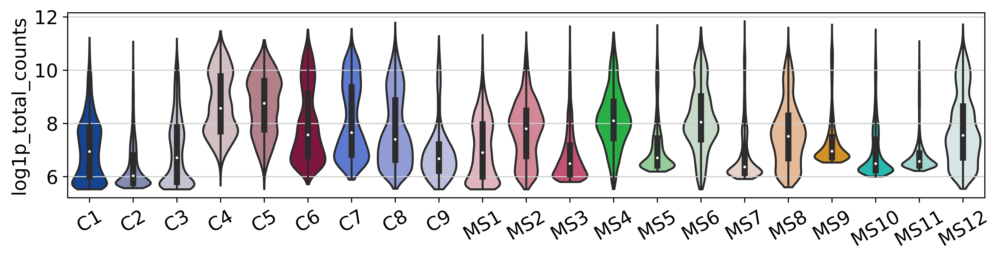

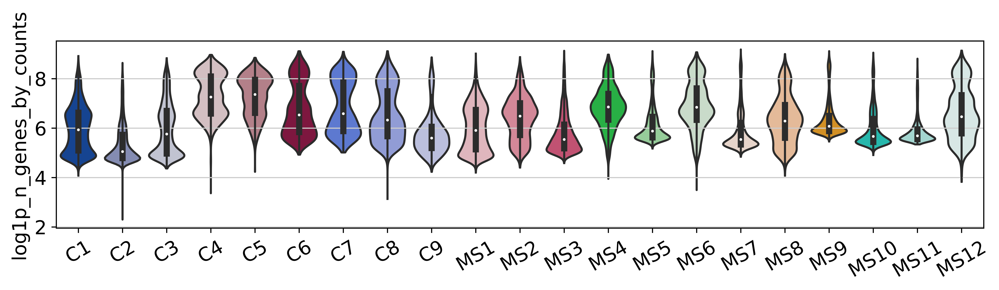

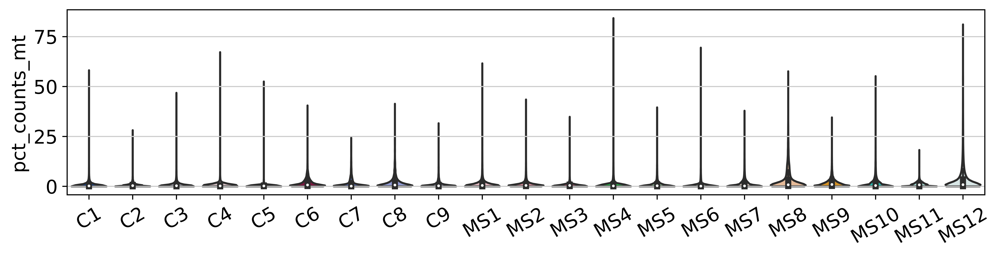

In [82]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'log1p_n_genes_by_counts'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='Sample', multi_panel=False, rotation=30)

In [83]:
mt_quantile = 0.975 
umi_quantile = 0.975
doublet_quantile = 0.975

samples = adata.obs.Sample.value_counts().index.to_list()
good_barcodes = []
for cur_sample in samples:
    
    # get just this sample
    cur_adata = adata[adata.obs.Sample == cur_sample]
    orig_cells = cur_adata.shape[0]
    
    # compute cutoffs for each sample
    mt_cutoff = cur_adata.obs.pct_counts_mt.quantile(mt_quantile)
    umi_cutoff = cur_adata.obs.total_counts.quantile(umi_quantile)
    doublet_cutoff = cur_adata.obs.doublet_scores.quantile(doublet_quantile)
    
    # subset the data based on thresholds
    cur_adata = cur_adata[(cur_adata.obs.pct_counts_mt < mt_cutoff) & (cur_adata.obs.total_counts < umi_cutoff) & (cur_adata.obs.doublet_scores < doublet_cutoff)]
    new_cells = cur_adata.shape[0]
    
    keep_cells = cur_adata.obs.barcode.to_list() 
    good_barcodes = good_barcodes + keep_cells
    print(cur_sample, 'removed ', orig_cells-new_cells, ', kept ', new_cells)

    

C2 removed  1113 , kept  13887
MS11 removed  1236 , kept  13764
MS10 removed  1199 , kept  13801
MS9 removed  1207 , kept  13793
MS7 removed  1199 , kept  13801
MS5 removed  1128 , kept  13872
MS3 removed  1197 , kept  13803
MS1 removed  820 , kept  9304
C3 removed  806 , kept  9244
C1 removed  783 , kept  8847
MS12 removed  581 , kept  6953
MS6 removed  391 , kept  4849
MS4 removed  368 , kept  4487
MS2 removed  368 , kept  4360
C6 removed  304 , kept  3634
C4 removed  259 , kept  3216
C8 removed  256 , kept  3068
C5 removed  244 , kept  2987
MS8 removed  219 , kept  2564
C9 removed  208 , kept  2549
C7 removed  200 , kept  2244


In [84]:
# subset the full data by the good barcodes
adata = adata[adata.obs.index.isin(good_barcodes)]
adata.shape

(165027, 36601)

In [85]:
# dataset-wide cutoffs:

adata = adata[adata.obs.n_genes_by_counts >= 250]
adata = adata[adata.obs.pct_counts_mt <= 10]

adata.shape

(114898, 36601)

## Process data for harmony

In [87]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [88]:
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'], n_jobs=16)
sc.pp.scale(adata, max_value=10)


In [89]:
sc.tl.pca(adata, svd_solver='arpack')

In [90]:
sc.external.pp.harmony_integrate(adata, key = 'Sample')

2021-11-30 19:38:25,618 - harmonypy - INFO - Iteration 1 of 10
2021-11-30 19:39:13,555 - harmonypy - INFO - Iteration 2 of 10
2021-11-30 19:40:01,165 - harmonypy - INFO - Iteration 3 of 10
2021-11-30 19:40:49,110 - harmonypy - INFO - Iteration 4 of 10
2021-11-30 19:41:23,041 - harmonypy - INFO - Iteration 5 of 10
2021-11-30 19:41:46,390 - harmonypy - INFO - Converged after 5 iterations


In [91]:
sc.pp.neighbors(adata, use_rep = 'X_pca_harmony', n_neighbors=20, n_pcs=30, metric='cosine')

In [92]:
sc.tl.umap(adata, min_dist=0.4, method='umap')

In [93]:
sc.tl.leiden(adata, resolution=1.5)

#compute dendrogram for the dotplot:
sc.tl.dendrogram(adata, 'leiden')

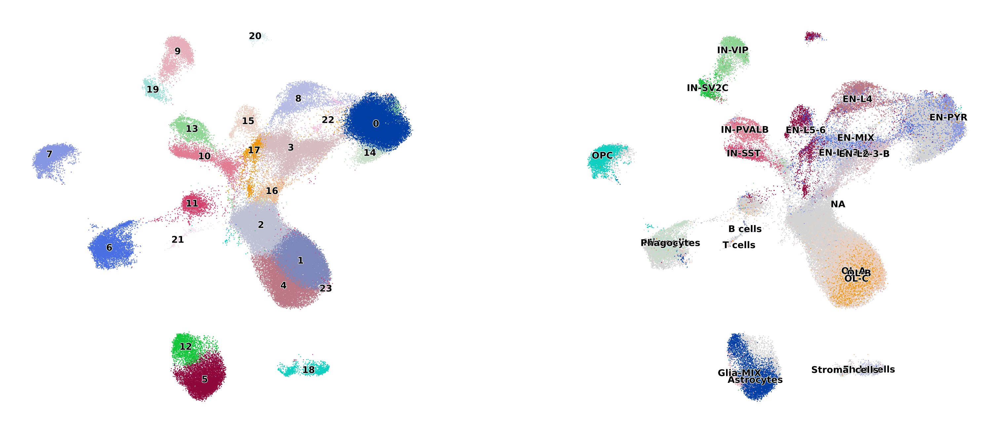

In [99]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['leiden', 'cell_type'],
    frameon=False, legend_loc='on data', 
    legend_fontoutline=0.5, legend_fontsize=5, 
    add_outline=False, title=['', ''], 
    save='_leiden.pdf'
)

In [98]:
adata.obs.columns

Index(['n_counts', 'doublet_scores', 'doublets', 'Sample', 'Study',
       'orig_barcode', 'batch', 'barcode', 'Run', 'age', 'sex',
       'Study_sample_ID', 'UK_MS_and_NIH_tissue_bank_sample_ID',
       'Tissue_block_#', 'Brain_region',
       'Inflammatory-demyelinating_lesion_stage', 'DMGM_(upper,_in_%_of_GM)',
       'DMGM_(deep,_in_%_of_GM)', 'DMWM_(in_%_of_WM)', 'PMI', 'RIN', 'Age',
       'Sex', 'Disease_duration_(years)', 'Clinical_disease_course',
       'Fraction_of_reads_in_cells', 'Sample_barcode', 'stage', 'cell_type',
       'pseudotime', 'Capbatch', 'Seqbatch', 'n_genes_by_counts',
       'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts',
       'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'leiden'],
      dtype='object')

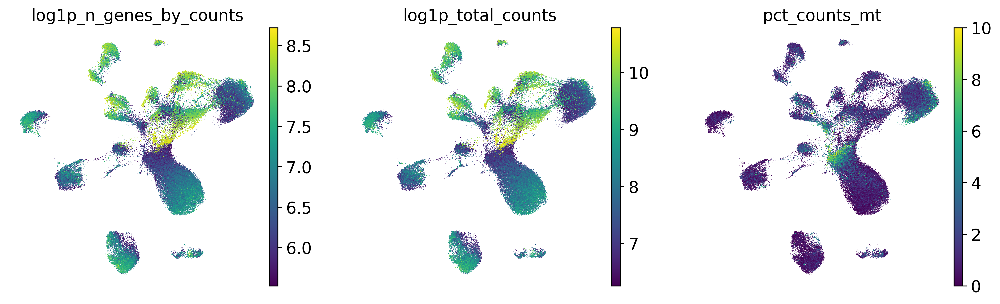

In [96]:
## plot QC vars
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_mt'],
    ncols=3,
    frameon=False, 
    add_outline=False, 
    save='_qc.pdf'
)


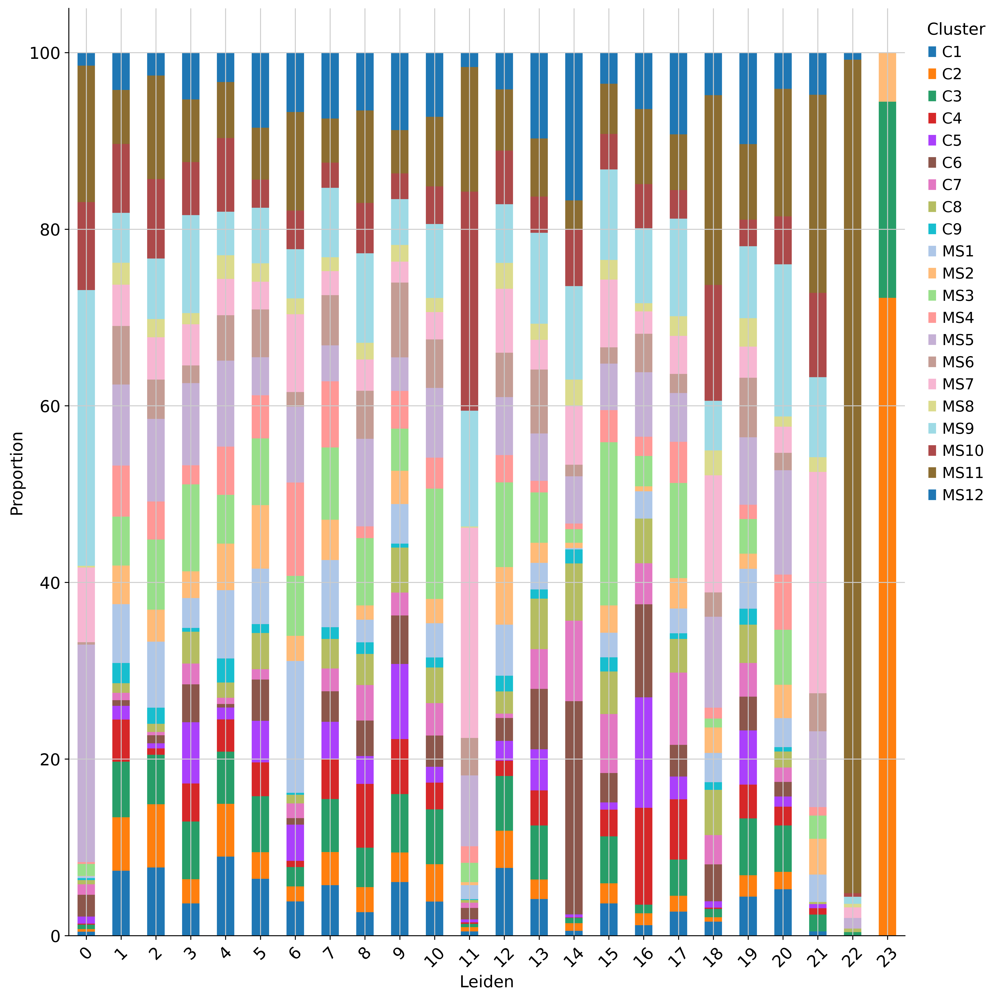

In [105]:
sc.settings.set_figure_params(dpi=300, figsize=(12,12), facecolor='white')
props = get_cluster_proportions(adata, cluster_key='Sample', sample_key='leiden')
plot_cluster_proportions(props, xlabel_rotation=45)

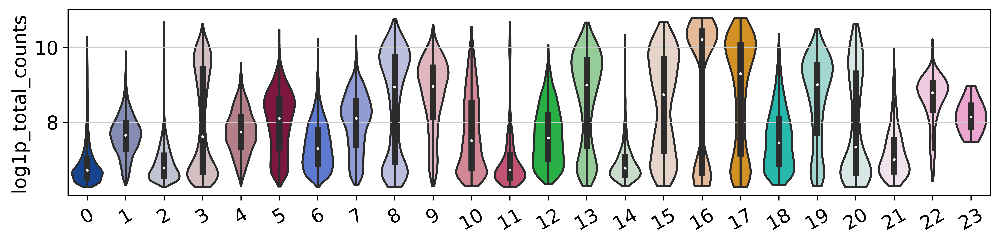

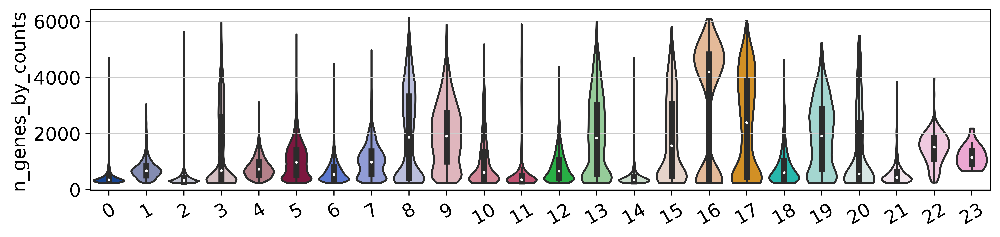

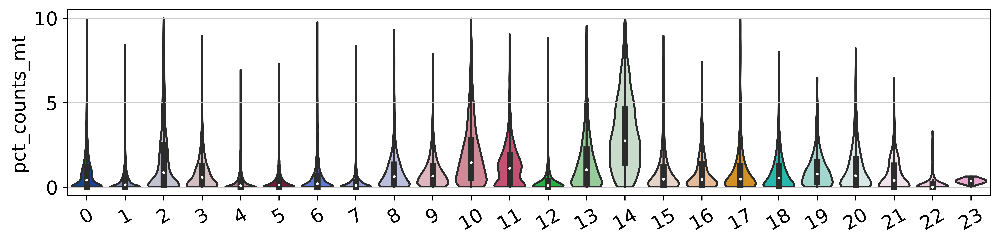

In [95]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)

In [102]:
print(adata.obs[adata.obs.leiden == '11'].cell_type.value_counts())
print(adata.obs[adata.obs.leiden == '11'].shape)

OL-B             108
EN-L5-6           58
OL-A              35
EN-L2-3-B         25
EN-PYR            23
EN-MIX            16
B cells           15
T cells           13
EN-L4             13
OL-C               4
OPC                3
EN-L2-3-A          2
Glia-MIX           1
IN-VIP             1
Stromal cells      0
Phagocytes         0
Astrocytes         0
Microglia          0
IN-SV2C            0
IN-PVALB           0
Endo cells         0
IN-SST             0
Name: cell_type, dtype: int64
(2922, 40)


In [100]:
# marker genes from dotplot:
marker_dict = {
    'ODC' : ['PLP1', 'MOBP', 'MOG'],
    'OPC' : ['PDGFRA', 'OLIG1'],
    'Neuron' : ['STMN2', 'SNAP25'],
    'EX': ['SLC17A7'],
    'INH': ['PVALB', 'SST', 'LAMP5', 'VIP', 'GAD1', 'GAD2'],
    'Microglia': ['CX3CR1', 'CSF1R', 'PTPRC'],
    'Ependyma':['FOXJ1', 'FAM216B'],
    'Astrocyte' : ['AQP4', 'GFAP'],
    'Mural' : ['CLDN5'],
    'Endothelial': ['FLT1'],
    'Pericyte': ['PDGFRB'],
    'VLMC': ['VTN']
}

categories: 0, 1, 2, etc.
var_group_labels: ODC, OPC, Neuron, etc.


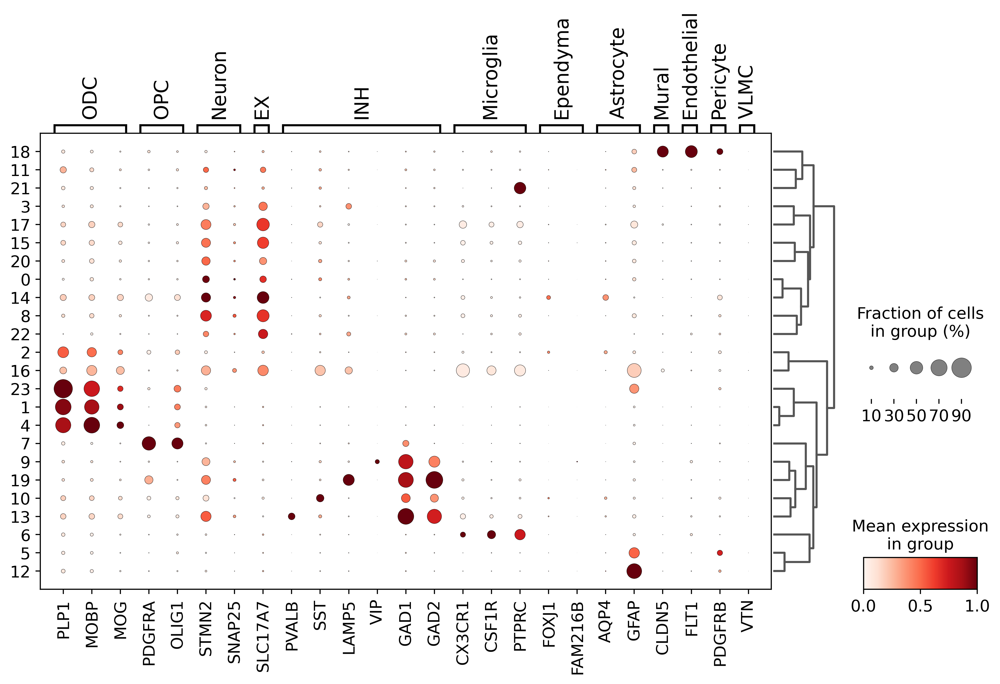

In [101]:
sc.pl.dotplot(adata, marker_dict, groupby='leiden', figsize=(12,6), standard_scale='var', dendrogram=True, save='filtered_markers.pdf')

## Filter low-quality clusters and re-cluster

In [108]:
clusters_to_remove = [
    '11', # doesn't have many markers expressed
    '16',
    '2',
    '23', # oligo / astro
    '14' # very low genes
]

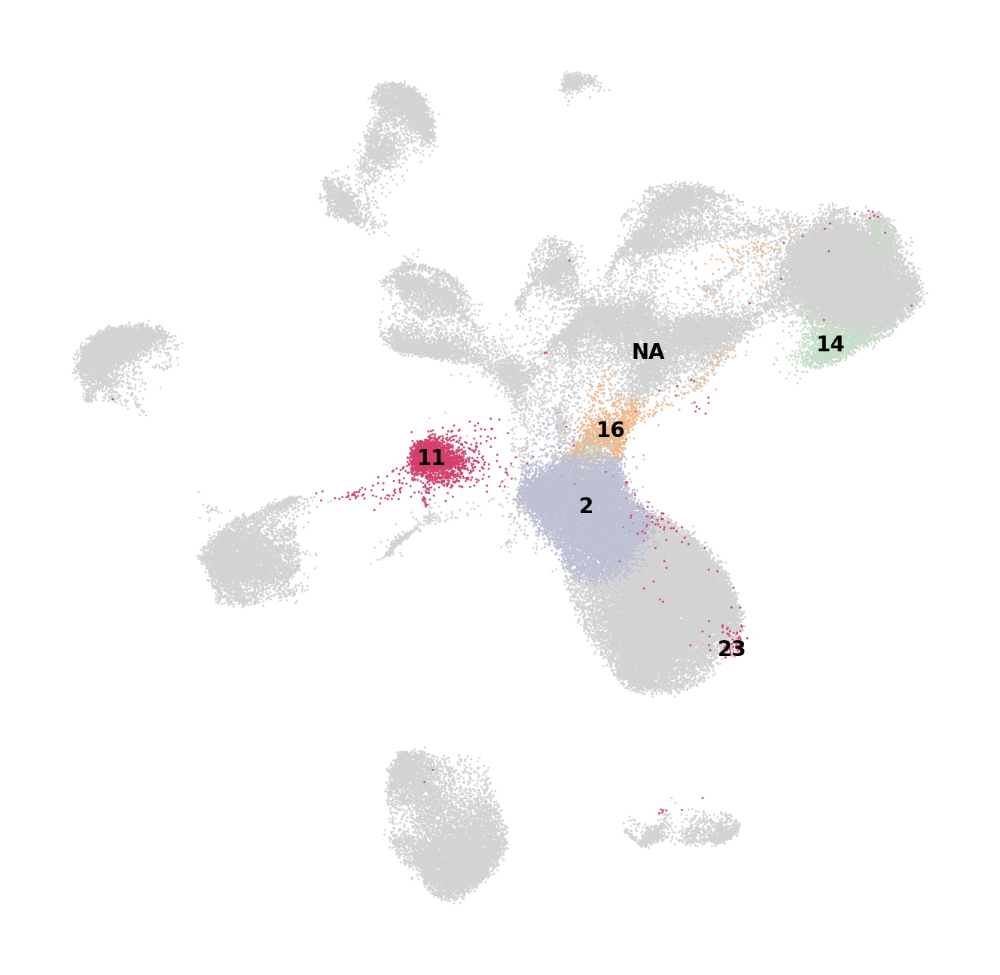

In [109]:
# clusters to remove based on low qc / conflicting markers
sc.settings.set_figure_params(dpi=200, figsize=(4,4), facecolor='white')
sc.pl.umap( adata,color=["leiden"], groups=clusters_to_remove, frameon=False, legend_fontsize=5, legend_loc='on data', title='')


In [110]:
# remove bad clusters:
adata = adata[~adata.obs.leiden.isin(clusters_to_remove)]
adata.shape

(94681, 36601)

In [111]:
sc.pp.neighbors(adata, use_rep = 'X_pca_harmony', n_neighbors=20, n_pcs=30, metric='cosine')
sc.tl.umap(adata, min_dist=0.4, method='umap')

In [112]:
sc.tl.leiden(adata, resolution=1)
sc.tl.dendrogram(adata, 'leiden')

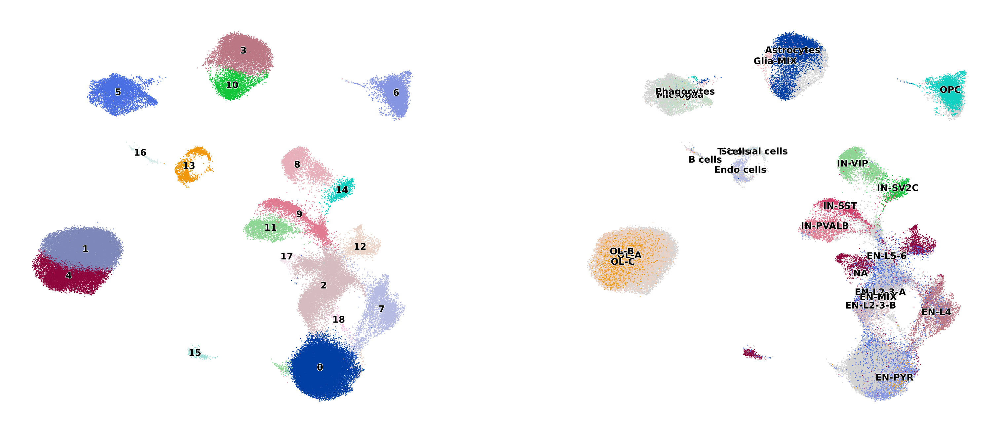

In [114]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['leiden', 'cell_type'],
    frameon=False, legend_loc='on data', 
    legend_fontoutline=0.5, legend_fontsize=5, 
    add_outline=False, title=['', ''], 
    save='_leiden_filtered.pdf'
)

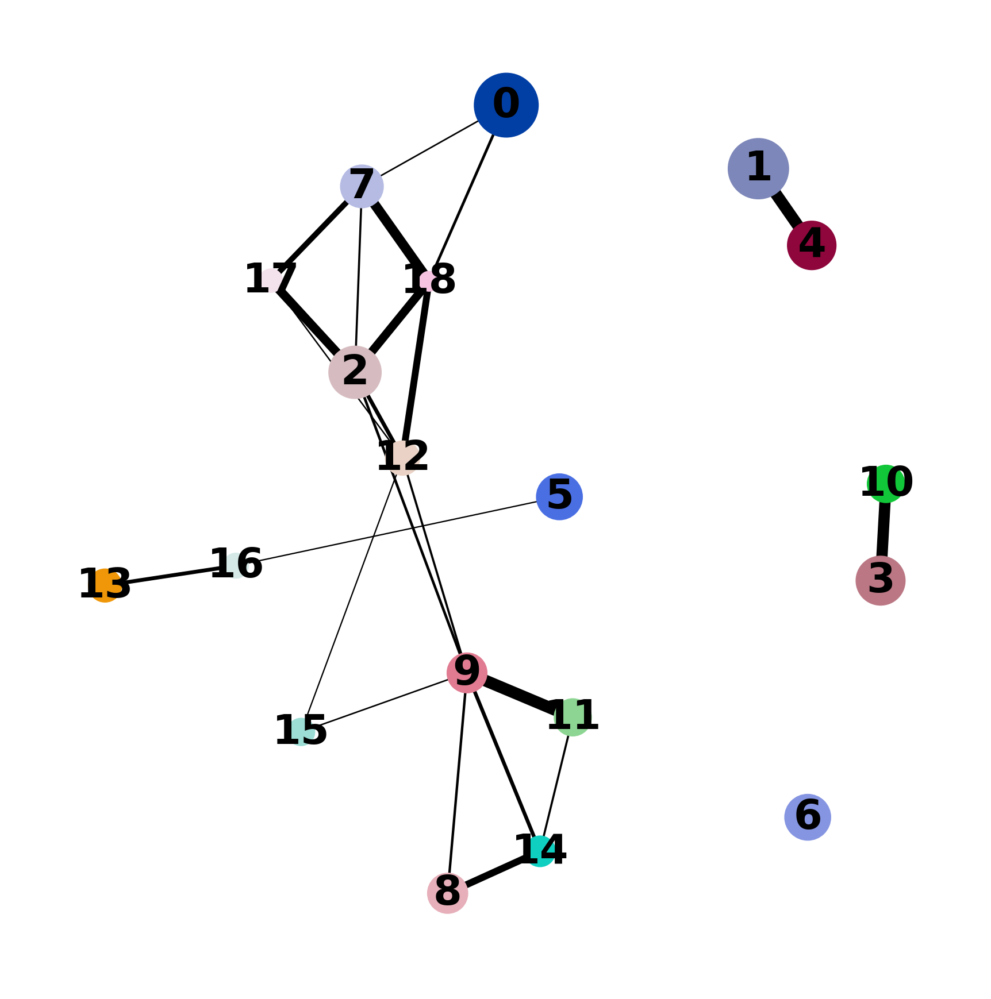

In [115]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.tl.paga(adata)
sc.pl.paga(
    adata, threshold=0.1, title='', edge_width_scale=0.5,
    frameon=False, save=True
)


In [116]:
# re-compute UMAP using paga as initial position
sc.tl.umap(adata, min_dist=0.4, init_pos='paga')

In [141]:
# remove bad clusters:
clusters_to_remove = [
    '17', '18'
]
adata = adata[~adata.obs.leiden.isin(clusters_to_remove)]
adata.shape

(94224, 36601)

In [147]:
sc.tl.dendrogram(adata, 'leiden')

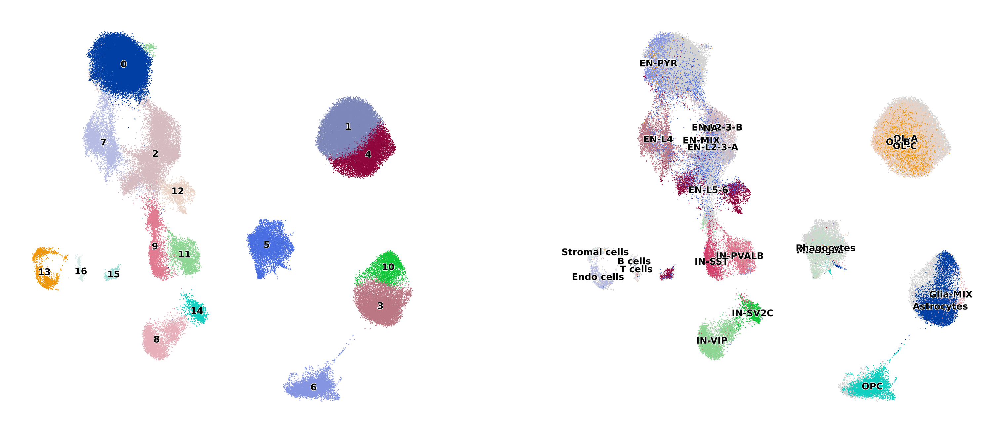

In [142]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['leiden', 'cell_type'],
    frameon=False, legend_loc='on data', 
    legend_fontoutline=0.5, legend_fontsize=5, 
    add_outline=False, title=['', ''], 
    save='_leiden_filtered_paga.pdf'
)

Trying to set attribute `.obs` of view, copying.
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1228: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'in_orig_study' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused c

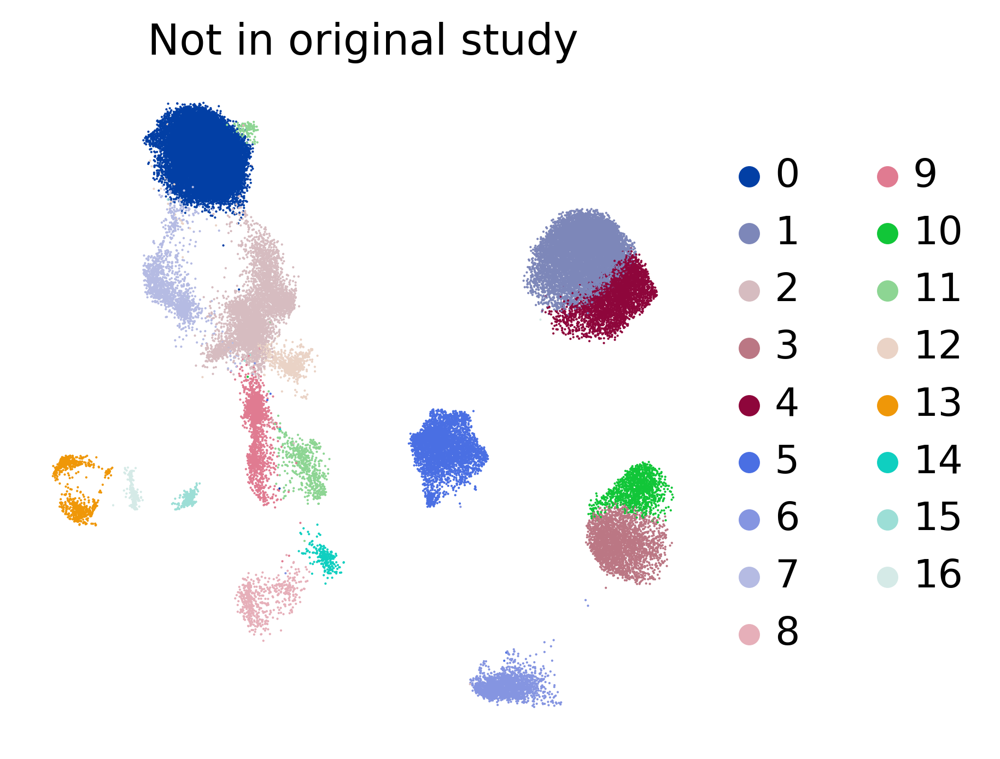

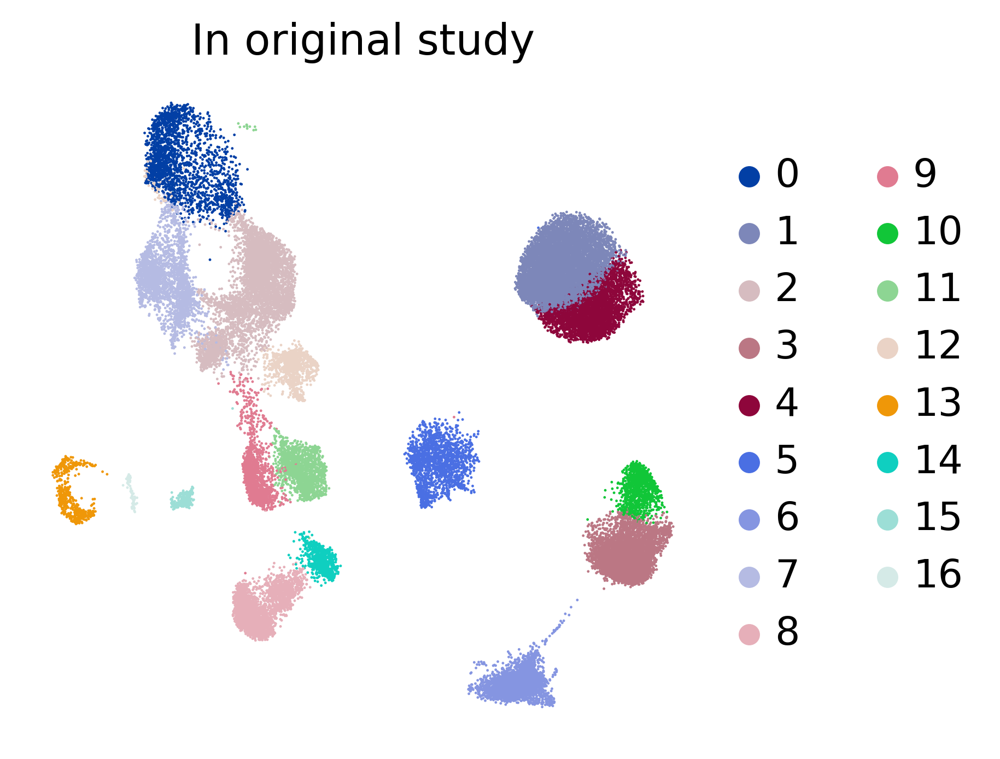

In [143]:
adata.obs['in_orig_study'] = ~adata.obs.cell_type.isnull()
adata.obs['in_orig_study'] = adata.obs['in_orig_study'].astype(str)

ax1 = sc.pl.umap(
    adata[adata.obs['in_orig_study'] == 'False'], color=['leiden'],
    frameon=False,
    legend_fontoutline=0.5,
    add_outline=False, title=['Not in original study'],
    return_fig = True
)

ax2 = sc.pl.umap(
    adata[adata.obs['in_orig_study'] == 'True'], color=['leiden'],
    frameon=False,
    legend_fontoutline=0.5,
    add_outline=False, title=['In original study'],
    return_fig = True
)

In [144]:
adata.obs['in_orig_study'].value_counts()

False    53920
True     40304
Name: in_orig_study, dtype: int64

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'in_orig_study' as categorical


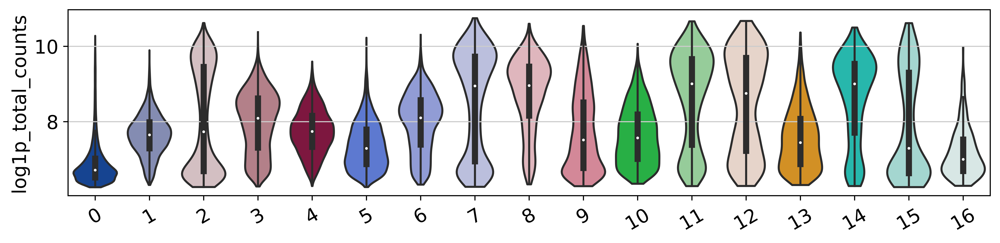

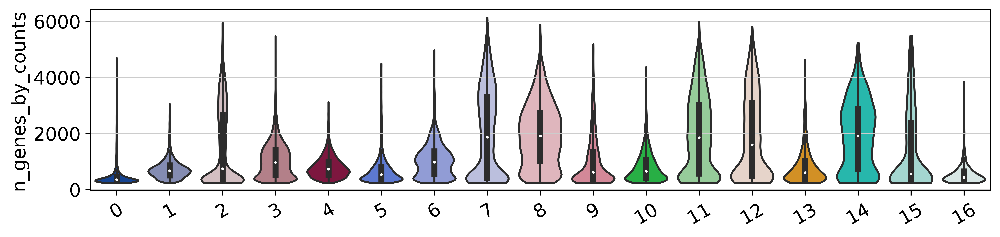

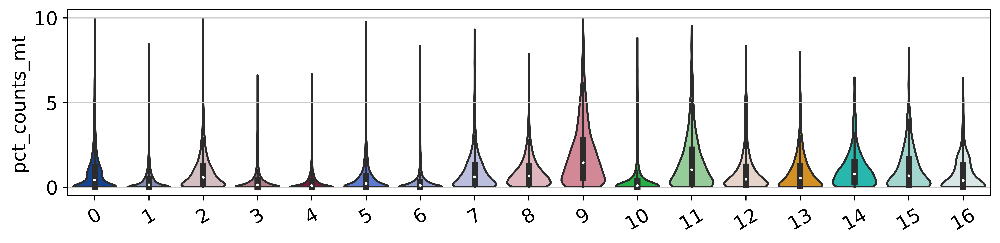

In [145]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(10,2.5), facecolor='white')
sc.pl.violin(adata,[ 'log1p_total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)

In [148]:
sc.pl.dotplot(adata, marker_dict, groupby='leiden', figsize=(12,6), standard_scale='var', dendrogram=True, save='filtered_markers.pdf')

categories: 0, 1, 2, etc.
var_group_labels: ODC, OPC, Neuron, etc.


## Annotate clusters

In [155]:

adata.obs['orig_cell_type'] = adata.obs['cell_type']
adata.obs = adata.obs.drop('cell_type', axis=1)

# load cluster anno df 
anno_df = pd.read_csv('/dfs3b/swaruplab/shared_lab/cross-disorder/meta_data/MS_Schirmer/Schirmer_leiden_clusters.csv')

anno_df.leiden = anno_df.leiden.astype(str)
temp = adata.obs.merge(
    anno_df, how='left',
    on = 'leiden')

adata.obs['cell_type'] = temp['cell_type'].astype(str).to_list()



/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scanpy/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical


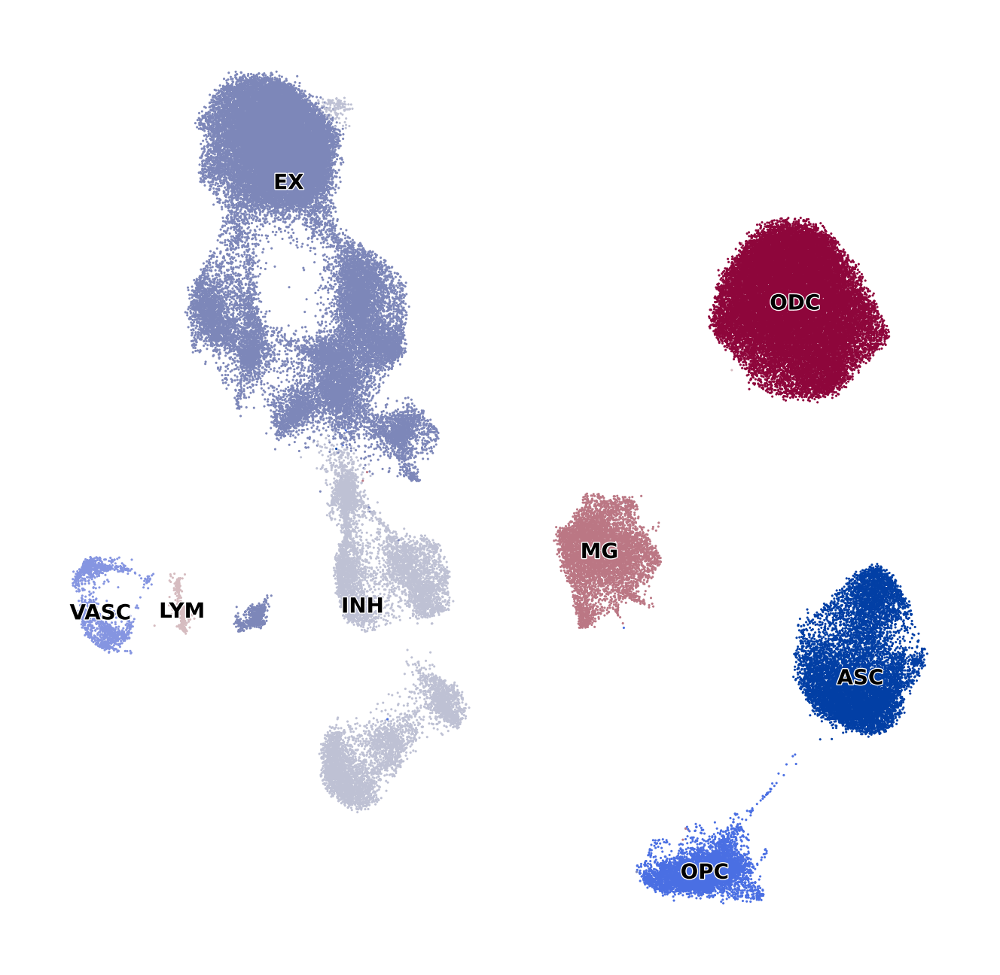

In [156]:
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['cell_type'],
    frameon=False, legend_loc='on data', 
    legend_fontoutline=0.5, legend_fontsize=5, 
    add_outline=False, title=[''], 
    save='_annotated.pdf'
)


## Save processed dataset

In [4]:
# write obs table 
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]
adata.obs.to_csv('{}/Schirmer_2019_processed_obs.csv'.format(data_dir))

# write var table
adata.var.to_csv('{}/Schirmer_2019_processed_var.csv'.format(data_dir))

In [158]:
# write anndata:
adata.write_h5ad('{}/Schirmer_2019_processed.h5ad'.format(data_dir))

In [6]:
# save the sparse matrix for Seurat:
X = adata.layers['counts']
X = scipy.sparse.csr_matrix.transpose(X)
io.mmwrite('{}/Schirmer_2019_counts.mtx'.format(data_dir), X)

In [7]:
# save the Harmony Matrix for Seurat:
pd.DataFrame(adata.obsm['X_pca_harmony']).to_csv('{}/Schirmer_2019_processed_harmony.csv'.format(data_dir))


In [3]:
adata = sc.read_h5ad('{}/Schirmer_2019_processed.h5ad'.format(data_dir))

## Plot categorical variables

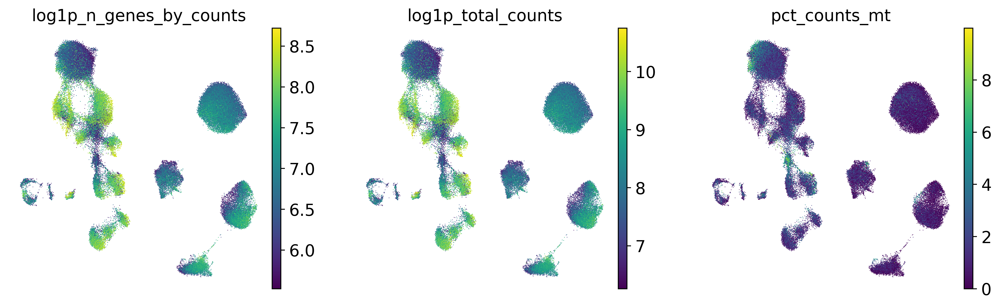

In [159]:
## plot QC vars
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_mt'],
    ncols=3,
    frameon=False, 
    add_outline=False, 
    save='_qc.pdf'
)


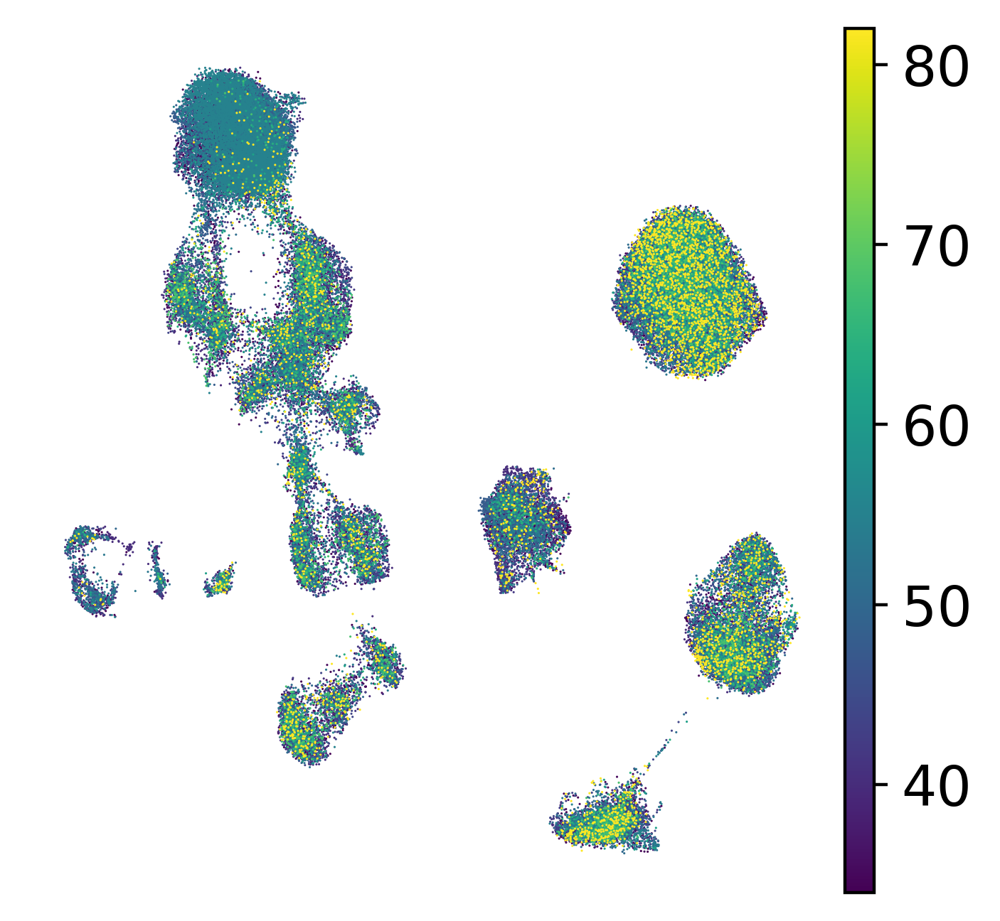

In [160]:
## Age
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['age'],
    ncols=3,
    frameon=False, title = '',
    add_outline=False, 
    save='_age.pdf'
)


In [162]:
adata.obs.columns

Index(['n_counts', 'doublet_scores', 'doublets', 'Sample', 'Study',
       'orig_barcode', 'batch', 'barcode', 'Run', 'age', 'sex',
       'Study_sample_ID', 'UK_MS_and_NIH_tissue_bank_sample_ID',
       'Tissue_block_#', 'Brain_region',
       'Inflammatory-demyelinating_lesion_stage', 'DMGM_(upper,_in_%_of_GM)',
       'DMGM_(deep,_in_%_of_GM)', 'DMWM_(in_%_of_WM)', 'PMI', 'RIN', 'Age',
       'Sex', 'Disease_duration_(years)', 'Clinical_disease_course',
       'Fraction_of_reads_in_cells', 'Sample_barcode', 'stage', 'pseudotime',
       'Capbatch', 'Seqbatch', 'n_genes_by_counts', 'log1p_n_genes_by_counts',
       'total_counts', 'log1p_total_counts', 'total_counts_mt',
       'log1p_total_counts_mt', 'pct_counts_mt', 'leiden', 'in_orig_study',
       'orig_cell_type', 'cell_type', 'UMAP_1', 'UMAP_2'],
      dtype='object')

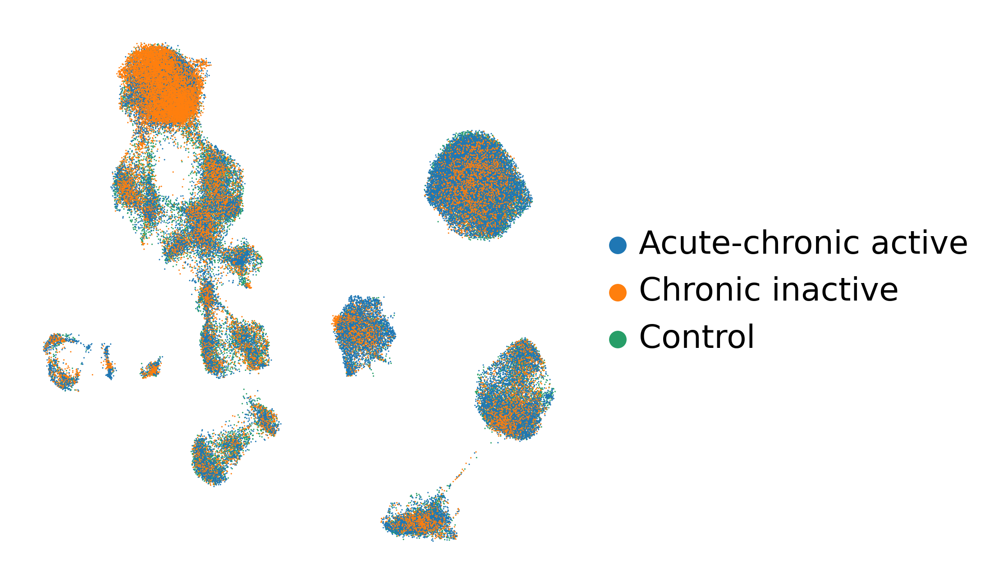

Acute-chronic active    38166
Chronic inactive        31800
Control                 24258
Name: Inflammatory-demyelinating_lesion_stage, dtype: int64

In [164]:
# MS Diagnosis
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['Inflammatory-demyelinating_lesion_stage'],
    frameon=False, 
    add_outline=False, title=[''], 
    save='_diagnosis.pdf'
)
adata.obs['Inflammatory-demyelinating_lesion_stage'].value_counts()

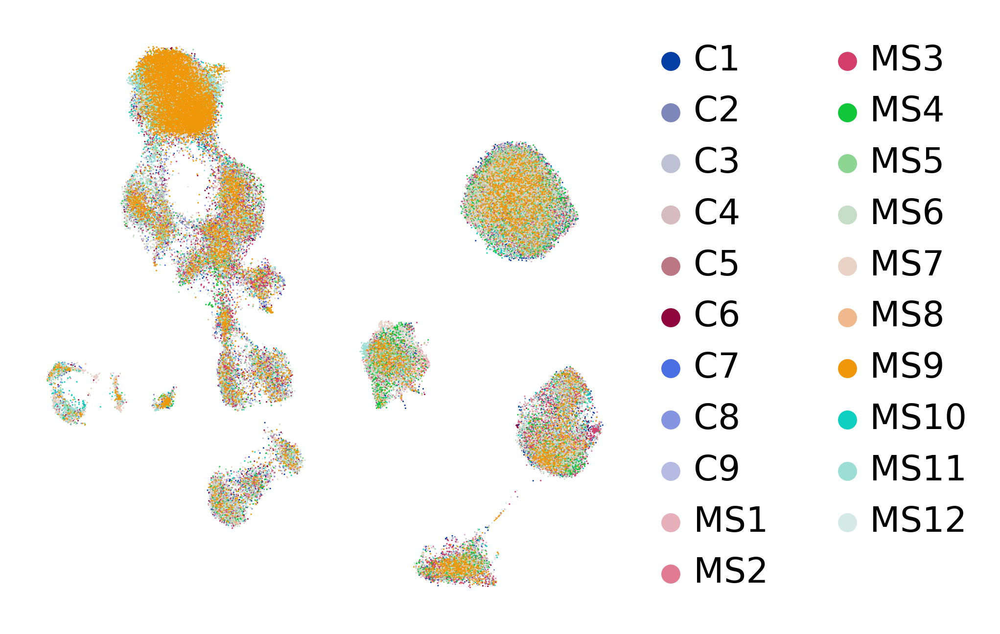

In [167]:
# Samples
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['Sample'],
    frameon=False, 
    add_outline=False, title=[''], 
    save='_samples.pdf'
)


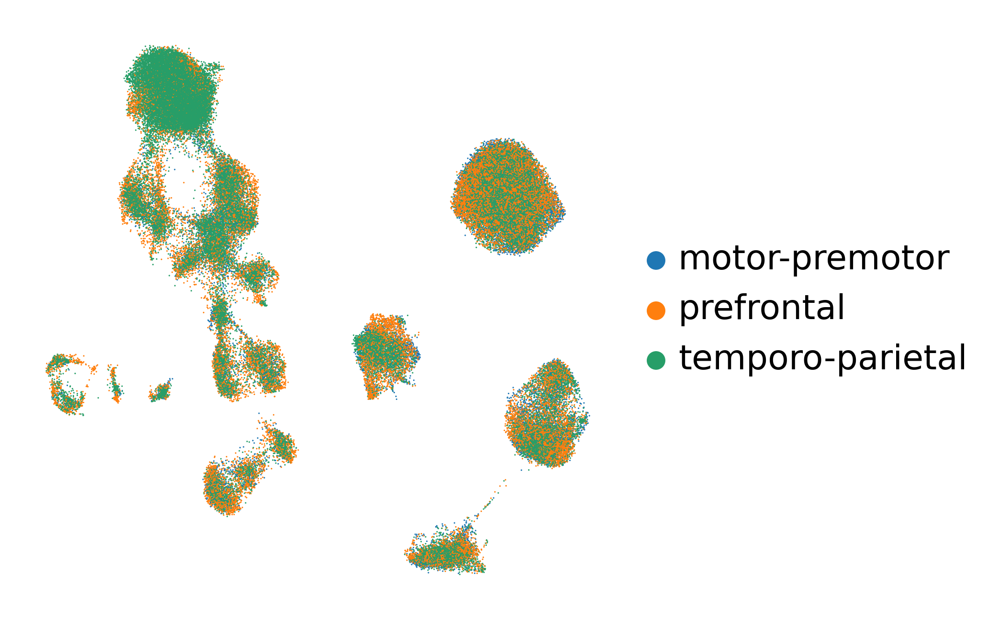

temporo-parietal    46459
prefrontal          31806
motor-premotor      15959
Name: Brain_region, dtype: int64

In [168]:
# brain regions 
sc.settings.set_figure_params(dpi=200, dpi_save=1000, figsize=(4,4), facecolor='white')
sc.pl.umap(
    adata, color=['Brain_region'],
    frameon=False, 
    add_outline=False, title=[''], 
    save='_regions.pdf'
)
adata.obs['Brain_region'].value_counts()